<hr style="height:2px;border:none"/>
<h1 align='center'> <img src="http://www.exalumnos.usm.cl/wp-content/uploads/2015/06/Isotipo-Negro.gif" title="Title text" width="20%" height="20%" />

INF-447 Tarea 1 Redes Neuronales Artificiales - 2020-1 </h1>
<H3 align='center'> Pregunta 3</H3>


<H3 align='center'> Integrantes: Andrea Freire - Yeiniel Alfonso - Francisco Sáez </H3>
<hr style="height:2px;border:none"/>



# 3. Interpretabilidad de CNNs, transfer learning y skip connections

Los modelos de aprendizaje automático, especialmente los modelos de aprendizaje profundo, a menudo se consideran una caja negra y difíciles de interpretar. Bueno, esta afirmación no es completamente cierta ni es completamente falsa. Es un hecho que depurar un modelo de aprendizaje profundo es mucho más difícil que otros modelos de aprendizaje automático, pero hay formas en las que puede obtener información sobre su modelo y, hasta cierto punto, puede ver lo que está sucediendo. Dado que trabajaremos con archivos .jpg mucho código vendrá dado, se darán ejemplos en el camino para que se familiarice con las herramientas sin la necesidad de entenderlas en su totalidad. **¡¡¡¡¡¡Evite trabajar de más y trabaje esta pregunta en _Colab_!!!!!** La gran mayoría del código de pre-procesamiento a utilizar, y ciertos tópicos ha cubrir, han sido sacados de https://www.kaggle.com/aakashnain/what-does-a-cnn-see/notebook , puede ocupar el código para guiarse, sin embargo se ha bajado el código para trabajar con tensorflow directamente. Aprecie que en los datasets de Kaggle, hay una sección notebooks, donde distintos usuarios suben distintas aplicaciones que le han dado al dataset en cuestión.  


<h1 align='center'> <img src="https://miro.medium.com/max/831/1*7Ip2_SeOz_BoruHEytEMlQ.png" width="60%" height="60%" /> </h1> 
<h1 align='center'></h1>

Para esto analizaremos el problema de clasificación de imágenes, en este caso clasificaremos 10 especies de monos, su descripción se puede encontrar en: https://www.kaggle.com/slothkong/10-monkey-species (No es necesario descargar el dataset trabajando en _Colab_). Este dataset será el más pesado que utilizaremos en esta tarea. **Recordar usar entorno de ejecución con acelerador GPU**. Veremos los temas de transfer learning, skip connections, y class activation mappings. Donde la primera herramienta nos ayudará a hacer el entrenamiento más ligero, la segunda nos permitirá atacar tener redes profundas con pesos fijos, y la última nos permetirá visualizar qué está viendo nuestra red CNN.


## 3.a Carga de datos (tan solo insertar datos kaggle, leer código y comentarios para entender la funcionalidad de cada celda).

##### I) Iniciaremos cargando los datos. Para esto necesitará crear una cuenta en kaggle, dirigirse a su perfil, ir a Account, y en la sección API apretar _Create new API token_ , se descargará un archivo kaggle.json, ábralo como archivo de texto y obtenga su username y key. Luego ejecute el siguiente código (desconozco por qué pero a veces hay que ejecutar el código 2 veces para que funcione). Solución obtenida desde el hilo: https://gist.github.com/jayspeidell/d10b84b8d3da52df723beacc5b15cb27

In [ ]:
username="asfreire"
key="f4f93e23360f63df65272541fdccefad"

!pip install -q kaggle
api_token = {"username":username,"key":key}
import json
import zipfile
import os
os.environ['KAGGLE_USERNAME'] = str(username)
os.environ['KAGGLE_KEY'] = str(key)
!kaggle datasets download -d slothkong/10-monkey-species
if not os.path.exists("/content/competitions/monillos"):
    os.makedirs("/content/competitions/monillos")
os.chdir('/content/competitions/monillos')
for file in os.listdir():
    if file[-4:]==".zip":
      zip_ref = zipfile.ZipFile(file, 'r')
      zip_ref.extractall()
      zip_ref.close()
!ls

 98% 538M/547M [00:02<00:00, 187MB/s]
100% 547M/547M [00:02<00:00, 192MB/s]
10-monkey-species.zip  monkey_labels.txt  training  validation


Ejecute el siguiente código como viene para generar los conjuntos de entrenamiento y validación, en este formato la primera columna indicará el archivo .jpg al que está ligado cada dato, y la columna labels indicará a qué clase pertenece. **Si le aparece un error de directorio volver a ejecutar celda anterior**

In [ ]:
from pathlib import Path
import os
import pandas as pd
import cv2
import numpy as np
from keras.applications.vgg16 import preprocess_input
import matplotlib.pyplot as plt

labels_dict= {'n0':0, 'n1':1, 'n2':2, 'n3':3, 'n4':4, 'n5':5, 'n6':6, 'n7':7, 'n8':8, 'n9':9}
training_data = Path('training/training/') 
validation_data = Path('validation/validation/') 
labels_path = Path('monkey_labels.txt')
# Creating a dataframe for the training dataset
train_df = []
for folder in os.listdir(training_data):
    # Define the path to the images
    imgs_path = training_data / folder
    # Get the list of all the images stored in that directory
    imgs = sorted(imgs_path.glob('*.jpg'))
    # Store each image path and corresponding label 
    for img_name in imgs:
        train_df.append((str(img_name), labels_dict[folder]))
train_df = pd.DataFrame(train_df, columns=['image', 'label'], index=None)
# shuffle the dataset 
train_df = train_df.sample(frac=1.).reset_index(drop=True)

# Creating dataframe for validation data in a similar fashion
valid_df = []
for folder in os.listdir(validation_data):
    imgs_path = validation_data / folder
    imgs = sorted(imgs_path.glob('*.jpg'))
    for img_name in imgs:
        valid_df.append((str(img_name), labels_dict[folder]))

        
valid_df = pd.DataFrame(valid_df, columns=['image', 'label'], index=None)
# shuffle the dataset 
valid_df = valid_df.sample(frac=1.).reset_index(drop=True)

OpenCV es una poderosa herramienta para computer vision:

_OpenCV (Open Source Computer Vision Library) is an open source computer vision and machine learning software library. OpenCV was built to provide a common infrastructure for computer vision applications and to accelerate the use of machine perception in the commercial products. Being a BSD-licensed product, OpenCV makes it easy for businesses to utilize and modify the code._

Procederemos a visualizar una imagen del dataset al azar. Familiarícese con las f° a utilizar

In [ ]:
# dimensions to consider for the images
img_rows, img_cols, img_channels = 224,224,3

# batch size for training  
batch_size=8

# total number of classes in the dataset
nb_classes=10

Como podrá inferir en base a la imágen mostrada, el dataset es muy pesado, por lo cual en lugar de trabajar directamente con un dataframe con los pixeles de la imágen, como en la pregunta 2, trabajaremos con la siguiente función.

In [ ]:
from keras.utils import to_categorical
def data_generator(data, batch_size, is_validation_data=False):
    # Get total number of samples in the data
    n = len(data)
    nb_batches = int(np.ceil(n/batch_size))

    # Get a numpy array of all the indices of the input data
    indices = np.arange(n)
    
    # Define two numpy arrays for containing batch data and labels
    batch_data = np.zeros((batch_size, img_rows, img_cols, img_channels), dtype=np.float32)
    batch_labels = np.zeros((batch_size, nb_classes), dtype=np.float32)
    
    while True:
        if not is_validation_data:
            # shuffle indices for the training data
            np.random.shuffle(indices)
            
        for i in range(nb_batches):
            # get the next batch 
            next_batch_indices = indices[i*batch_size:(i+1)*batch_size]
            
            # process the next batch
            for j, idx in enumerate(next_batch_indices):
                img = cv2.imread(data.iloc[idx]["image"])
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                label = data.iloc[idx]["label"]
                img = cv2.resize(img, (img_rows, img_cols)).astype(np.float32)
                batch_data[j] = img
                batch_labels[j] = to_categorical(label,num_classes=nb_classes)
            
            batch_data = preprocess_input(batch_data)
            yield batch_data, batch_labels

In [ ]:
#training data generator 
train_data_gen = data_generator(train_df, batch_size)

# validation data generator 
valid_data_gen = data_generator(valid_df, batch_size, is_validation_data=True)

##### II) Visualice una imágen para cada clase de mono indicado su raza. Básese en el siguiente código.

OpenCV es una poderosa herramienta para computer vision:

_OpenCV (Open Source Computer Vision Library) is an open source computer vision and machine learning software library. OpenCV was built to provide a common infrastructure for computer vision applications and to accelerate the use of machine perception in the commercial products. Being a BSD-licensed product, OpenCV makes it easy for businesses to utilize and modify the code._

Procederemos a visualizar una imagen del dataset al azar. Familiarícese con las f° a utilizar

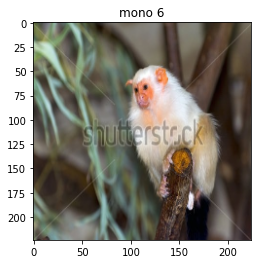

In [ ]:
idx= np.random.randint(100) # <- random number
sample_image = cv2.imread(valid_df.iloc[idx]['image']) #read image from validation set
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB) #set color
sample_image = cv2.resize(sample_image, (img_rows, img_cols)) #resize, because .jpg images are from diferent size
sample_label = valid_df.iloc[idx]["label"] #get label
sample_image_processed = np.expand_dims(sample_image, axis=0) #not used here, but to transform image from (pixel,pixel,canal) to (obs, pixel, pixel, canal)
sample_image_processed = preprocess_input(sample_image_processed) #transformation for vgg16
plt.title("mono "+str(sample_label))
plt.imshow(sample_image)
plt.show()

## 3.b Transfer learning

El aprendizaje por transferencia es un método de aprendizaje automático en el que un modelo desarrollado para una tarea se reutiliza como punto de partida para un modelo en una segunda tarea.

Es un enfoque popular en el aprendizaje profundo en el que los modelos previamente entrenados se utilizan como punto de partida en la visión por computadora y las tareas de procesamiento del lenguaje natural, dada la gran cantidad de recursos informáticos y de tiempo necesarios para desarrollar modelos de redes neuronales sobre estos problemas y los enormes saltos en las habilidades que proporcionan sobre problemas relacionados. El concepto de transfer learning abarca más que este tipo de implementación en específico, p.ej, en el área de reinforcement learning se le puede llamar transfer learning al hecho de utilizar demostraciones humanas para ayudar a una red neuronal a resolver un _task_ o _multi-task_ en específico.

<h1 align='center'> <img src="https://neurohive.io/wp-content/uploads/2018/11/vgg16-1-e1542731207177.png" width="60%" height="60%" /> </h1> 
<h1 align='center'> VGG16 </h1> 

Para este item utilizaremos la red vgg16 como red base (info: https://neurohive.io/en/popular-networks/vgg16/) desarrollada por Oxford.

##### I) Procederemos a obtener la red VGG16 desde keras.applications, retirar su arquitectura densa, congelar sus pesos, y añadir una capa densa propia entrenable.

In [ ]:
from keras.applications.vgg16 import VGG16
from keras.layers import Dropout,Dense,Flatten
from keras.optimizers import RMSprop
from keras.callbacks import History, EarlyStopping
import tensorflow as tf
from keras.applications.vgg16 import preprocess_input
tf.keras.backend.clear_session()
tf.compat.v1.disable_eager_execution()

base_model = VGG16(input_shape=(img_rows, img_cols, img_channels), weights='imagenet', include_top=True)
#  get the output of the last layer
base_model_output = base_model.layers[-2].output
# # add new layers 
x = Dropout(0.7)(base_model_output)
output = Dense(10, activation='softmax')(x)
# define a new model 
model = tf.keras.models.Model(base_model.input, output)
# # Freeze all the base model layers
for layer in base_model.layers[:-1]:
    layer.trainable=False
my_callbacks = [History(), # Returns validation and training loss
    EarlyStopping(patience=2,monitor="val_accuracy", #Stops training when the validation loss doesnt get better in n°patience consecutive epochs
                                     restore_best_weights=True)]
model.compile(loss='categorical_crossentropy', optimizer=RMSprop(1e-3), metrics=['accuracy'])

553467904/553467096 [==============================] - 7s 0us/step


In [ ]:
model.summary()

Model: "functional_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)      

In [ ]:
# number of training and validation steps for training and validation
nb_train_steps = int(np.ceil(len(train_df)/batch_size))
nb_valid_steps = int(np.ceil(len(valid_df)/batch_size))
# number of epochs 
nb_epochs=3

hist = model.fit(train_data_gen,      # ¿Demasiado lento?, revisar estar usando entorno de ejecución en modo GPU. Debiese demorarse aprox. 40 secs por epoch. Dejar verbose
                                          # para seguir el entrenamiento, esto tomará su tiempo en comparación con las demás secciones.
                              epochs=nb_epochs, 
                              steps_per_epoch=nb_train_steps, 
                              validation_data=valid_data_gen, 
                              validation_steps=nb_valid_steps,
                              callbacks=my_callbacks)

Epoch 1/3
137/137 [==============================] - ETA: 0s - batch: 68.0000 - size: 8.0000 - loss: 1.2815 - accuracy: 0.7235WARNING:tensorflow:From /usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/training_v1.py:2048: Model.state_updates (from tensorflow.python.keras.engine.training) is deprecated and will be removed in a future version.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
137/137 [==============================] - 36s 263ms/step - batch: 68.0000 - size: 8.0000 - loss: 1.2815 - accuracy: 0.7235 - val_loss: 0.1224 - val_accuracy: 0.9596
Epoch 2/3
137/137 [==============================] - 38s 274ms/step - batch: 68.0000 - size: 8.0000 - loss: 0.4027 - accuracy: 0.9197 - val_loss: 0.0912 - val_accuracy: 0.9743
Epoch 3/3
137/137 [==============================] - 37s 272ms/step - batch: 68.0000 - size: 8.0000 - loss: 0.2817 - accuracy: 0.9516 - val_loss: 0.0363 - val_accuracy: 0.9890


##### II) Grafique los errores y accuracy de entrenamiento y validación a lo largo de los epochs. **Comente**

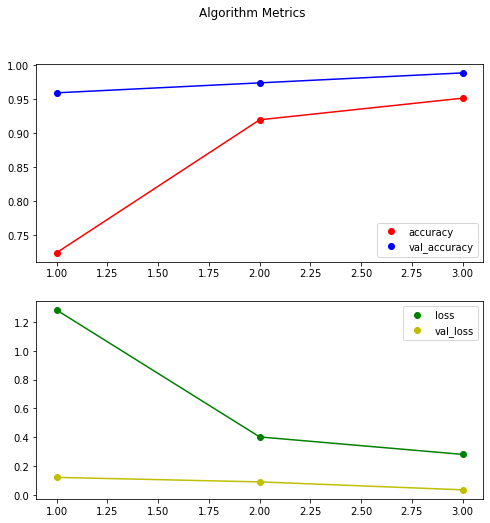

In [ ]:
import matplotlib.pyplot as plt
hist.history
hist.history['accuracy']
hist.history['val_accuracy']
hist.history['loss']
hist.history['val_loss']
r = range(1,4,1)
fig, axs = plt.subplots(2)
plt.rcParams['figure.figsize'] = [8,8]
fig.suptitle('Algorithm Metrics')
axs[0].plot(r, hist.history['accuracy'], 'ro', label='accuracy')
axs[0].plot(r, hist.history['val_accuracy'], 'bo', label='val_accuracy')
axs[0].plot(r, hist.history['accuracy'], 'r')
axs[0].plot(r, hist.history['val_accuracy'], 'b')
axs[0].legend()
#axs[0].show()
axs[1].plot(r, hist.history['loss'], 'go', label='loss')
axs[1].plot(r, hist.history['val_loss'], 'yo', label='val_loss')
axs[1].plot(r, hist.history['loss'], 'g')
axs[1].plot(r, hist.history['val_loss'], 'y')
axs[1].legend()
fig.show()


Se puede ver que el accuracy es bueno en la validacion, tambien se puede ver el trabajo del gradiente al intentar llegar al optimo como progresivamente en cada una de las epoch mejora el accuracy y la perdida(loss). El accuracy de validacion es superior que el del entrenamiento. En el caso del error se puede ver que el error de validacion presenta una disminucion al momento de validar la informacion.

Para evitar reentrenar redes al reconectarse, la red neuronal entrenada se puede guardar (arquitectura, pesos, y configuración de entrenamiento) del siguiente modo:

In [ ]:
import sys
sys.path.append('saved_model')
model.save('saved_model/3_b_i') #guardar
#model=tf.keras.models.load_model('saved_model/3_b_i/') #<- cargar modelo

INFO:tensorflow:Assets written to: saved_model/3_b_i/assets


##### III) **(Las preguntas de este ítem 2.b se tendrán que volver a implementar para futuras preguntas)** 

Realice la visualización del input (con título predicted label y true label), Class Activation Map (con título del label y salida de la red correspondiente), y superposición de input y CAM correspondiente al predicted label. **Deberá** modificar el código para obtener lo solicitado para 10 entradas distintas (1 para cada clase de mono) y su CAM para cada una de las 10 clases de monos. En total para cada clase de mono deberá obtener: 1 imágen de entrada de la clase de mono en cuestión, 10 CAM una para cada neurona del output de la red, y 1 superposición de la imágen de entrada y el CAM correspondiente a la predicción (por lo tanto, 120 imágenes en total). **Las imágenes tienen que ser claras, cada una de tamaño semejante a las que entrega el siguiente código.** Ocupe su herramienta gráfica preferida.

Apoyándose de las visualizaciones responda todas las preguntas siguientes:

**1) ¿Qué es CAM?, ¿Cómo nos ayuda a entender la visualización de nuestra CNN?** Puede limitarse a responder con la información entregada en el artículo https://medium.com/@GaganaB/class-activation-maps-551477720679 (si es que se le acabaron las visitas a medium, puede entrar en modo incógnito de manera ilimitada) y en el video https://www.youtube.com/watch?v=vTY58-51XZA&ab_channel=LazyProgrammer

**2) ¿Dónde se enfoca la red para verificar a qué clase de mono pertenece la imágen? ¿Qué estrategia asume la red para reconocer cada clase de mono?** 

1)Los mapas de activación de clases son una técnica simple para obtener las regiones de imagen discriminativas utilizadas por una CNN para identificar una clase específica en la imagen. En otras palabras, un mapa de activación de clases (CAM) nos permite ver qué regiones de la imagen eran relevantes para esta clase.

2)La red se enfoca en la utima capa convolucional que es la penultima capa de la red neuronal. La CAM o el map de calor sirve para visualizar a donde se esta enfocando la red. Segun los graficos en la forma de la cabeza los rasgos, el largo de las extremidades, el torso y la cola. Tiene buen desempeño

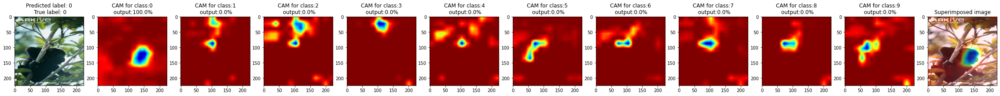

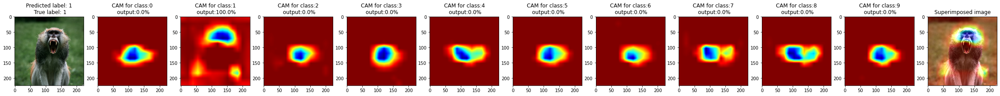

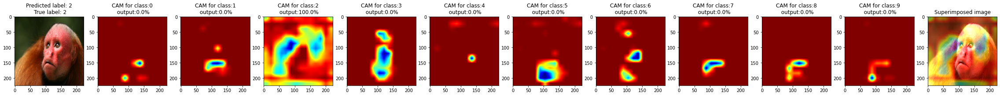

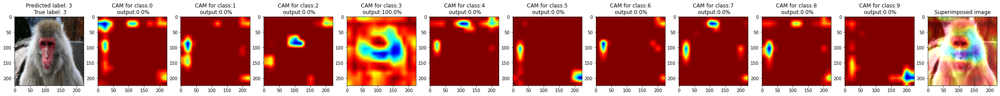

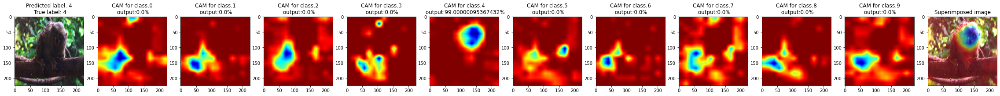

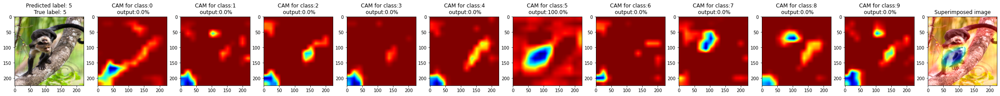

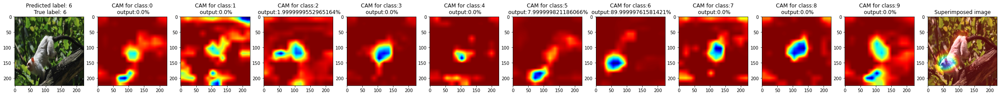

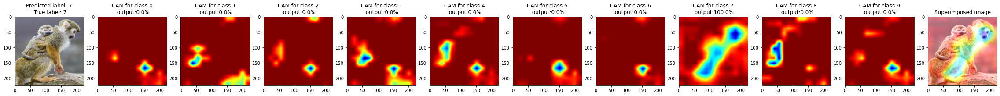

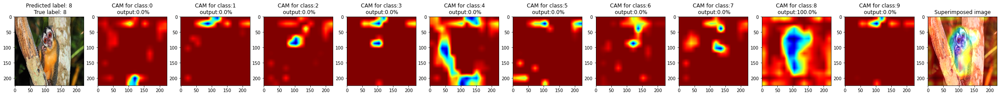

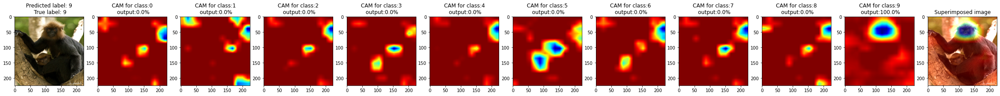

In [ ]:
plt.rcParams["figure.figsize"]=[40,8]
from keras import backend as K

for j in range(0,10,1):
  
  while True:
    # get random image, true label, and predicted label
    idx= np.random.randint(100) # <- random number
    true_label=valid_df.iloc[idx]['label']
    if(j == true_label):
        break
  

  ####### VISUALIZACIÓN INPUT
  sample_image = cv2.imread(valid_df.iloc[idx]['image'])
  sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)
  sample_image = cv2.resize(sample_image, (img_rows, img_cols))
  sample_label = valid_df.iloc[idx]["label"]
  sample_image_processed = np.expand_dims(sample_image, axis=0)
  sample_image_processed = preprocess_input(sample_image_processed)
  predicted_label=np.argmax(model.predict(sample_image_processed), axis=-1)[0]
  plt.subplot(1,12,1)
  plt.title("Predicted label: "+str(predicted_label)+"\n True label: "+str(true_label))
  plt.imshow(sample_image)# <- Image is ready to plot

  ##### Visualización CAM
  heatmaps=[]
  kk=0
  predicted_label=np.argmax(model.predict(sample_image_processed), axis=-1)[0] #repeated for clearness
  for k in range(0,10,1):#[0,predicted_label]:
    predicted_output = model.output[:, k]
    # choose the last conv layer in your model
    last_conv_layer = model.get_layer('block5_conv3') #<....... you'll need to look what's the name of the last conv model.summary())
    grads = K.gradients(predicted_output, last_conv_layer.output)[0] #predicted output=loss, last_conv_layer=input al gradiente, ¿qué calculará el gradiente entonces?
    # take mean gradient per feature map
    grads = K.mean(grads, axis=(0,1,2))
    # Define a function that generates the values for the output and gradients
    evaluation_function = K.function([model.input], [grads, last_conv_layer.output[0]]) #en eager executions disabled estamos trabajando con tensores continuamente, 
                                                                                        # si siguen el código se darán cuenta que evaluation function mantiene 
                                                                                        # las definiciones de variables
    # get the values
    grads_values, conv_ouput_values = evaluation_function([sample_image_processed]) #run evaluation function
    # iterate over each feature map in yout conv output and multiply
    # the gradient values with the conv output values. This gives an 
    # indication of "how important a feature is"
    for i in range(conv_ouput_values.shape[-1]): # we have 512 features in our last conv layer
        conv_ouput_values[:,:,i] *= grads_values[i]
    # create a heatmap
    heatmap = np.mean(conv_ouput_values, axis=-1)
    # remove negative values
    heatmap = np.maximum(heatmap, 0)
    # re-scale
    heatmap /= heatmap.max()
    # get the heatmap for class activation map(CAM)
    heatmap = cv2.resize(heatmap, (sample_image.shape[0], sample_image.shape[1]))
    heatmap = heatmap *255
    heatmap = np.clip(heatmap, 0, 255).astype(np.uint8)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    plt.subplot(1,12,2+kk)
    plt.title("CAM for class:"+ str(k)+"\n output:"+str(np.round(model.predict(sample_image_processed)[0,k],2)*100)+"%")
    plt.imshow(heatmap)# <- Image is ready to plot
    kk+=1
    heatmaps.append(heatmap) # <- correct it
  # get the superimposed image
  super_imposed_image = heatmaps[j] * 0.5 + sample_image #<- correct it  
  super_imposed_image = np.clip(super_imposed_image, 0,255).astype(np.uint8)
  plt.subplot(1,12,12)
  plt.title("Superimposed image")
  plt.imshow(super_imposed_image)# <- Image is ready to plot
  plt.show()

##### IV) **(Las preguntas de este ítem 2.b se tendrán que volver a implementar para futuras preguntas)** Visualice los feature maps de **todas** las capas convolucionales del modelo para una entrada de su elección (mantenga el id de esta imágen para cuando tenga que visualizar nuevamente en 3.c y 3.d). Apóyese en el siguiente código que las genera para la primera capa. 

**Pregunta:** ¿Cómo se relaciona esta información respecto a lo que nos entrega CAM? ¿Qué feature map ocupa CAM para construirse?

CAM muestra los features caracteristicos de la clase que se aprendieron por medio del entrenamiento. Estos features se encuentran en la ultima capa convolucional. 

In [ ]:
# get random image, SELECCIONE UNA A GUSTO
#idx= np.random.randint(100) # <- random number
true_label=valid_df.iloc[73]['label']
idx =73
####### VISUALIZACIÓN INPUT
sample_image = cv2.imread(valid_df.iloc[idx]['image'])
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)
sample_image = cv2.resize(sample_image, (img_rows, img_cols))
sample_label = valid_df.iloc[idx]["label"]
sample_image_processed = np.expand_dims(sample_image, axis=0)
sample_image_processed = preprocess_input(sample_image_processed)
print(idx,"-73")

73 -73


In [ ]:
from keras.models import Sequential
def get_n_layers(max_layer, original_model):
  truncated_model = Sequential()
  for layer in range(max_layer): #first is the input
    truncated_model.add(original_model.get_layer(index=layer))
  truncated_model.summary()
  return truncated_model

In [ ]:
vis_model=get_n_layers(2,model)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
Total params: 1,792
Trainable params: 0
Non-trainable params: 1,792
_________________________________________________________________


In [ ]:
vis_model.output_shape

(None, 224, 224, 64)

In [ ]:
fet_maps_stacked=vis_model.predict(sample_image_processed)[0,:,:,:]
dim0,dim1,dim2,dim3  = vis_model.output_shape
feature_maps=np.zeros((dim1*8,dim2*8))
k=0
for i in range(8):
  for j in range(8):
      feature_map = fet_maps_stacked[:,:,k]
      feature_map -= feature_map.mean()
      feature_map /= feature_map.std()
      feature_map *=255
      feature_map = np.clip(feature_map, 0, 255).astype(np.uint8)
      feature_maps[dim1*i:dim1*(i+1),dim1*j:dim1*(j+1)]=feature_map
      k+=1

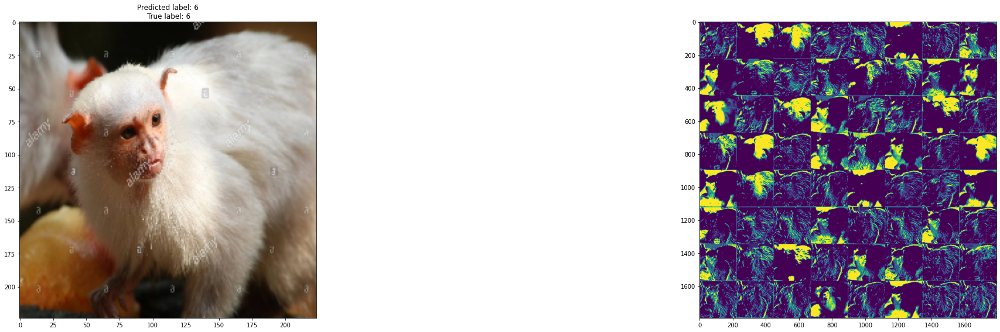

In [ ]:
plt.subplot(1,2,1)
plt.title("Predicted label: "+str(np.argmax(model.predict(sample_image_processed), axis=-1)[0])+"\n True label: "+str(true_label))
plt.imshow(sample_image)# <- Image is ready to plot
plt.subplot(1,2,2)
plt.imshow(feature_maps)
plt.tight_layout()
plt.show()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
Total params: 1,792
Trainable params: 0
Non-trainable params: 1,792
_________________________________________________________________
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
Total params: 38,720
Trainable params: 0
Non-trainable params: 38,720
_________________________________________________________________
Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
bloc

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in true_divide
  app.launch_new_instance()


Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 56, 56, 256)     

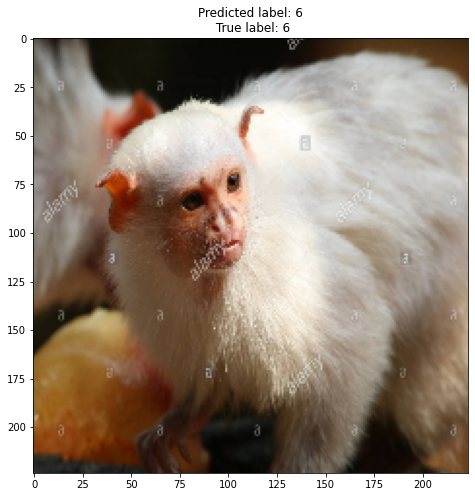

In [ ]:
plt.subplot(1,2,1)
plt.title("Predicted label: "+str(np.argmax(model.predict(sample_image_processed), axis=-1)[0])+"\n True label: "+str(true_label))
plt.imshow(sample_image)# <- Image is ready to plot

fmaps = []
for x in range(2,20,1):
  vis_model=get_n_layers(x,model)
  fet_maps_stacked=vis_model.predict(sample_image_processed)[0,:,:,:]
  dim0,dim1,dim2,dim3  = vis_model.output_shape
  feature_maps=np.zeros((dim1*8,dim2*8))
  k=0
  for i in range(8):
    for j in range(8):
        feature_map = fet_maps_stacked[:,:,k]
        feature_map -= feature_map.mean()
        feature_map /= feature_map.std()
        feature_map *=255
        feature_map = np.clip(feature_map, 0, 255).astype(np.uint8)
        feature_maps[dim1*i:dim1*(i+1),dim1*j:dim1*(j+1)]=feature_map
        k+=1
  fmaps.append(feature_maps)
plt.show()

18


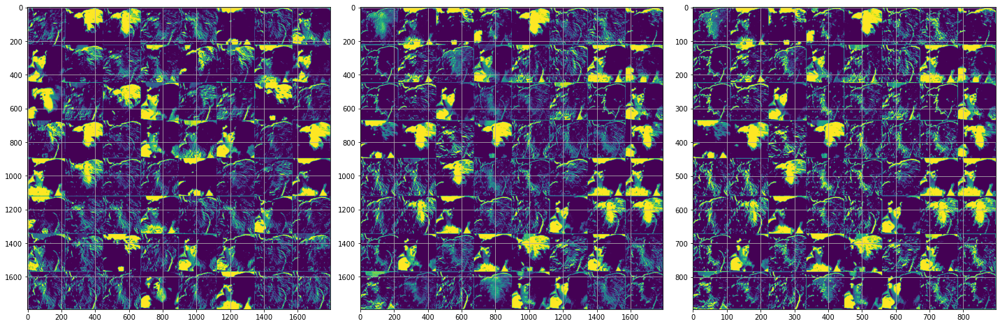

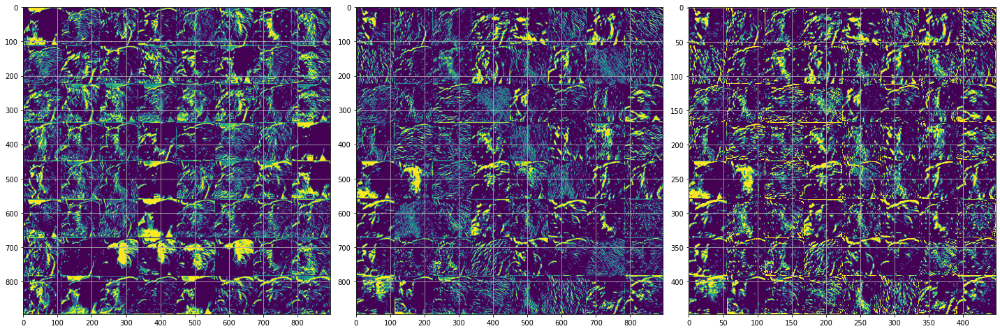

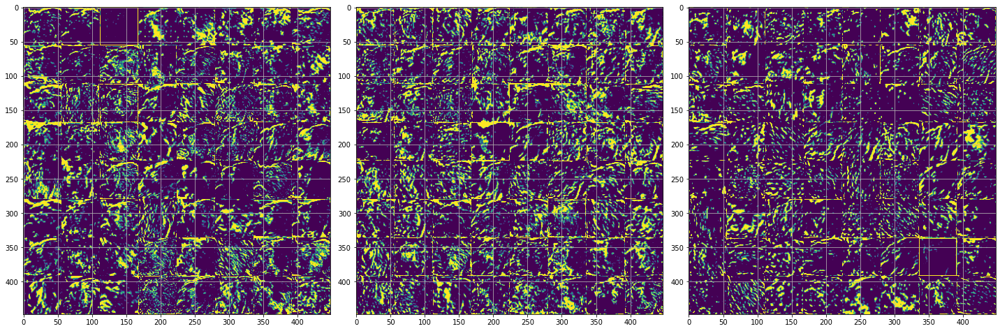

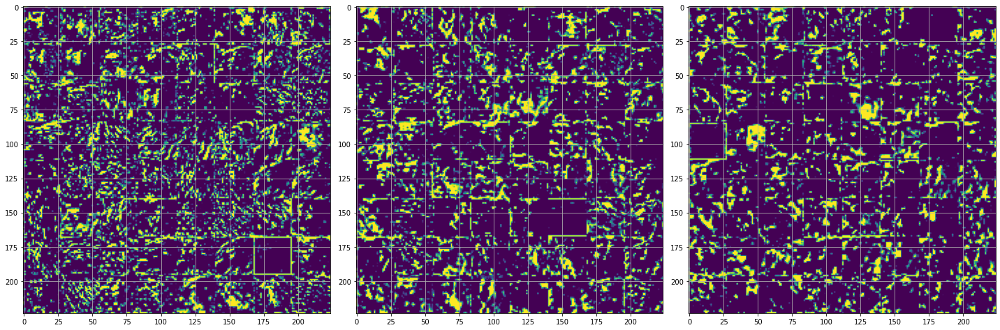

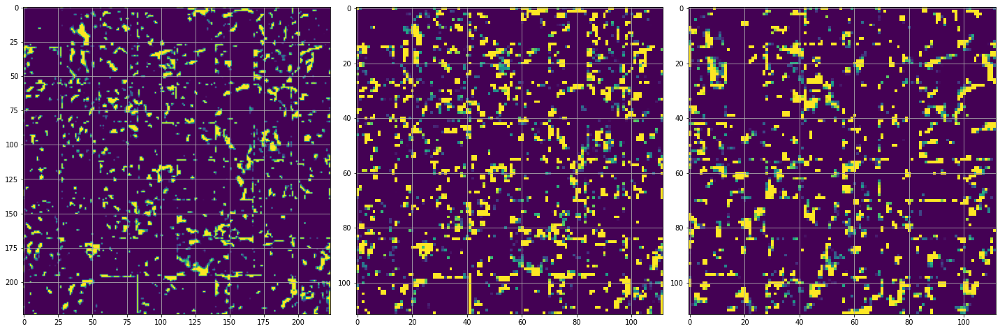

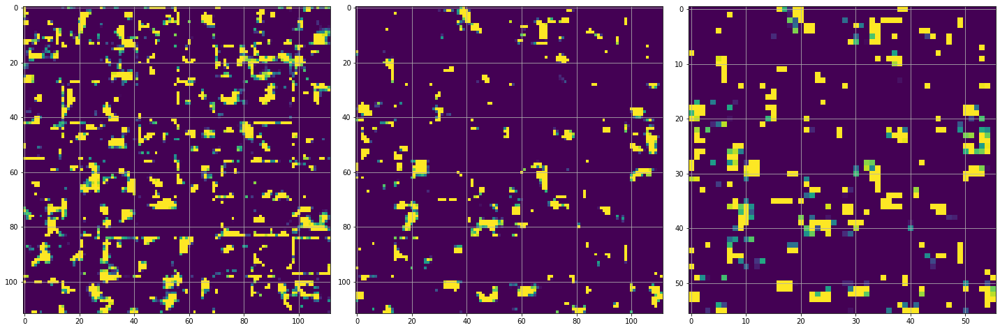

In [ ]:
fs = len(fmaps)
print(fs)
plt.rcParams['figure.figsize'] = [20,20]
for x in range(6):
  for y in range(3): 
    if (3*x)+y == fs:
      break
    plt.subplot(1,3,y+1)
    #print(3*x+y)
    plt.imshow(fmaps[3*x+y])
    plt.tight_layout()
    plt.grid()
  plt.show()
  if (3*x)+y == fs:
      break

## 3.c Transfer learning parte II
I) **Repetir los puntos I) a IV) de la sección anterior** usando como red base VGG19 (Si es que desea utilizar otra no hay problema, visitar: https://keras.io/api/applications/). Para la visualización de CAM y feature maps, use las mismas imágenes de entrada para mejor comparación.


**A partir de los resultados responda: ¿Cómo cambió la estrategia de esta red respecto a la del punto anterior?**

La red VGG19 tiene un desempenio menor que la red VGG16. El cambio son 3 capas de diferencia. En los mapas de activacion se puede ver que se activan mas de una zona en las diferentes clases, parece que no enfoca bien los objetos, esto se muestra tanto en el valor del accuracy como lo que muestran las CAM. 

In [ ]:
# dimensions to consider for the images
img_rows, img_cols, img_channels = 224,224,3

# batch size for training  
batch_size=8

# total number of classes in the dataset
nb_classes=10

In [ ]:
#training data generator 
train_data_gen = data_generator(train_df, batch_size)

# validation data generator 
valid_data_gen = data_generator(valid_df, batch_size, is_validation_data=True)

In [ ]:
from keras.applications.vgg19 import VGG19
from keras.applications.vgg19 import preprocess_input
from keras.applications.inception_resnet_v2 import InceptionResNetV2
from keras.applications.inception_resnet_v2 import preprocess_input

from keras.applications.nasnet import NASNetLarge
from keras.layers import Dropout,Dense,Flatten
from keras.optimizers import RMSprop
from keras.callbacks import History, EarlyStopping
import tensorflow as tf
from keras.applications.nasnet import preprocess_input
tf.keras.backend.clear_session()
tf.compat.v1.disable_eager_execution()

base_model1 = VGG19(input_shape=(img_rows, img_cols, img_channels), weights='imagenet', include_top=True)
#  get the output of the last layer
base_model_output1 = base_model1.layers[-2].output
# # add new layers 
x = Dropout(0.7)(base_model_output1)
output = Dense(10, activation='softmax')(x)
# define a new model 
model1 = tf.keras.models.Model(base_model1.input, output)
# # Freeze all the base model layers
for layer in base_model1.layers[:-1]:
    layer.trainable=False
my_callbacks = [History(), # Returns validation and training loss
    EarlyStopping(patience=2,monitor="val_accuracy", #Stops training when the validation loss doesnt get better in n°patience consecutive epochs
                                     restore_best_weights=True)]
model1.compile(loss='categorical_crossentropy', optimizer=RMSprop(1e-3), metrics=['accuracy'])

In [ ]:
base_model.summary()
model.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

In [ ]:
# number of training and validation steps for training and validation
nb_train_steps = int(np.ceil(len(train_df)/batch_size))
nb_valid_steps = int(np.ceil(len(valid_df)/batch_size))
# number of epochs 
nb_epochs=3

hist = model1.fit(train_data_gen,      # ¿Demasiado lento?, revisar estar usando entorno de ejecución en modo GPU. Debiese demorarse aprox. 40 secs por epoch. Dejar verbose
                                          # para seguir el entrenamiento, esto tomará su tiempo en comparación con las demás secciones.
                              epochs=nb_epochs, 
                              steps_per_epoch=nb_train_steps, 
                              validation_data=valid_data_gen, 
                              validation_steps=nb_valid_steps,
                              callbacks=my_callbacks)

Epoch 1/3
137/137 [==============================] - 38s 274ms/step - batch: 68.0000 - size: 8.0000 - loss: 3.0067 - accuracy: 0.1953 - val_loss: 1.6791 - val_accuracy: 0.3860
Epoch 2/3
137/137 [==============================] - 37s 267ms/step - batch: 68.0000 - size: 8.0000 - loss: 2.2868 - accuracy: 0.3358 - val_loss: 1.3492 - val_accuracy: 0.5368
Epoch 3/3
137/137 [==============================] - 36s 266ms/step - batch: 68.0000 - size: 8.0000 - loss: 1.9548 - accuracy: 0.4288 - val_loss: 1.1776 - val_accuracy: 0.6029


II)

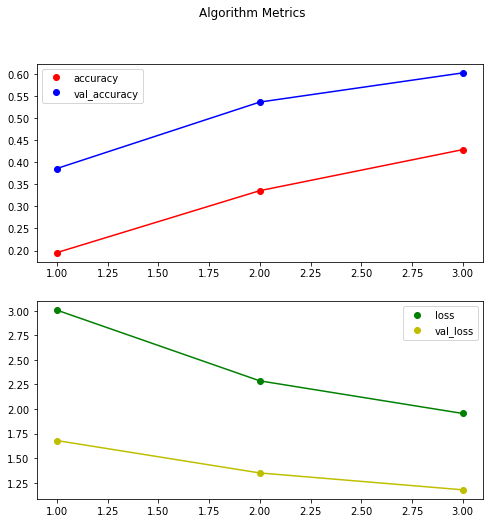

In [ ]:
import matplotlib.pyplot as plt
hist.history
hist.history['accuracy']
hist.history['val_accuracy']
hist.history['loss']
hist.history['val_loss']
r = range(1,4,1)
plt.rcParams['figure.figsize'] = [8,8]
fig, ax = plt.subplots(2)
#fig.set_size_inches(18.5, 10.5)
fig.suptitle('Algorithm Metrics')
ax[0].plot(r, hist.history['accuracy'], 'ro', label='accuracy')
ax[0].plot(r, hist.history['val_accuracy'], 'bo', label='val_accuracy')
ax[0].plot(r, hist.history['accuracy'], 'r')
ax[0].plot(r, hist.history['val_accuracy'], 'b')
ax[0].legend()
#axs[0].show()
ax[1].plot(r, hist.history['loss'], 'go', label='loss')
ax[1].plot(r, hist.history['val_loss'], 'yo', label='val_loss')
ax[1].plot(r, hist.history['loss'], 'g')
ax[1].plot(r, hist.history['val_loss'], 'y')
ax[1].legend()
fig.show()


III) 

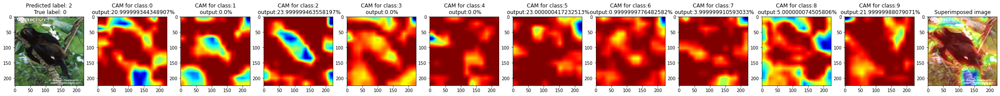

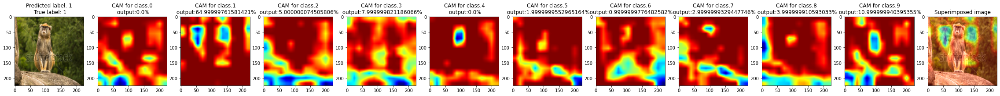

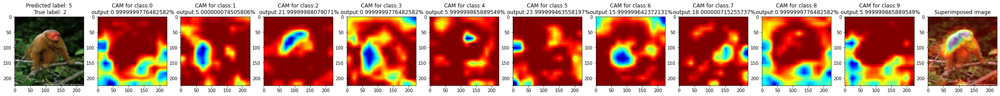

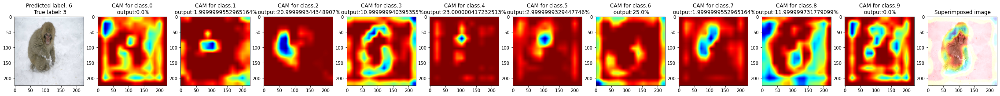

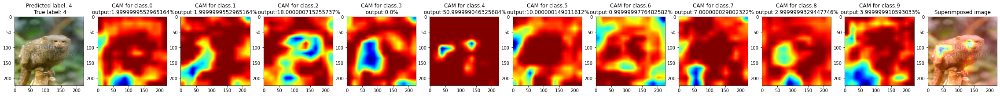

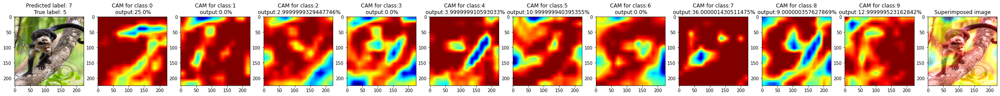

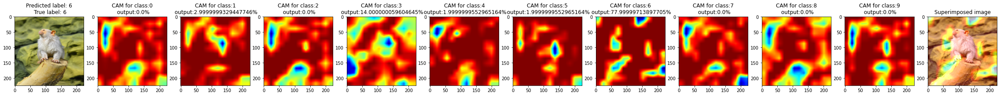

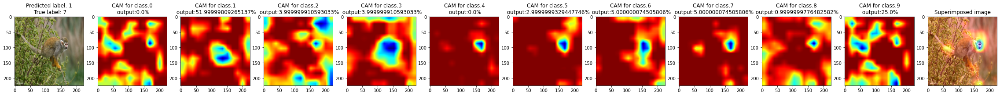

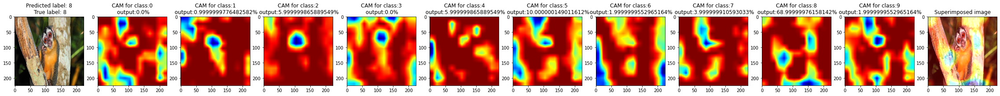

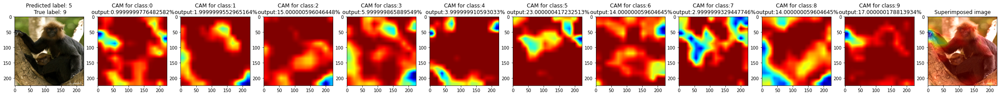

In [ ]:
plt.rcParams["figure.figsize"]=[40,8]
from keras import backend as K

for j in range(0,10,1):
  
  while True:
    # get random image, true label, and predicted label
    idx= np.random.randint(100) # <- random number
    true_label=valid_df.iloc[idx]['label']
    if(j == true_label):
        break
  

  ####### VISUALIZACIÓN INPUT
  sample_image = cv2.imread(valid_df.iloc[idx]['image'])
  sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)
  sample_image = cv2.resize(sample_image, (img_rows, img_cols))
  sample_label = valid_df.iloc[idx]["label"]
  sample_image_processed = np.expand_dims(sample_image, axis=0)
  sample_image_processed = preprocess_input(sample_image_processed)
  predicted_label=np.argmax(model1.predict(sample_image_processed), axis=-1)[0]
  plt.subplot(1,12,1)
  plt.title("Predicted label: "+str(predicted_label)+"\n True label: "+str(true_label))
  plt.imshow(sample_image)# <- Image is ready to plot

  ##### Visualización CAM
  heatmaps=[]
  kk=0
  predicted_label=np.argmax(model1.predict(sample_image_processed), axis=-1)[0] #repeated for clearness
  for k in range(0,10,1):#[0,predicted_label]:
    predicted_output = model1.output[:, k]
    # choose the last conv layer in your model
    last_conv_layer = model1.get_layer('block5_conv3') #<....... you'll need to look what's the name of the last conv model.summary())
    grads = K.gradients(predicted_output, last_conv_layer.output)[0] #predicted output=loss, last_conv_layer=input al gradiente, ¿qué calculará el gradiente entonces?
    # take mean gradient per feature map
    grads = K.mean(grads, axis=(0,1,2))
    # Define a function that generates the values for the output and gradients
    evaluation_function = K.function([model1.input], [grads, last_conv_layer.output[0]]) #en eager executions disabled estamos trabajando con tensores continuamente, 
                                                                                        # si siguen el código se darán cuenta que evaluation function mantiene 
                                                                                        # las definiciones de variables
    # get the values
    grads_values, conv_ouput_values = evaluation_function([sample_image_processed]) #run evaluation function
    # iterate over each feature map in yout conv output and multiply
    # the gradient values with the conv output values. This gives an 
    # indication of "how important a feature is"
    for i in range(conv_ouput_values.shape[-1]): # we have 512 features in our last conv layer
        conv_ouput_values[:,:,i] *= grads_values[i]
    # create a heatmap
    heatmap = np.mean(conv_ouput_values, axis=-1)
    # remove negative values
    heatmap = np.maximum(heatmap, 0)
    # re-scale
    heatmap /= heatmap.max()
    # get the heatmap for class activation map(CAM)
    heatmap = cv2.resize(heatmap, (sample_image.shape[0], sample_image.shape[1]))
    heatmap = heatmap *255
    heatmap = np.clip(heatmap, 0, 255).astype(np.uint8)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    plt.subplot(1,12,2+kk)
    plt.title("CAM for class:"+ str(k)+"\n output:"+str(np.round(model1.predict(sample_image_processed)[0,k],2)*100)+"%")
    plt.imshow(heatmap)# <- Image is ready to plot
    kk+=1
    heatmaps.append(heatmap) # <- correct it
  # get the superimposed image
  super_imposed_image = heatmaps[j] * 0.5 + sample_image #<- correct it  
  super_imposed_image = np.clip(super_imposed_image, 0,255).astype(np.uint8)
  plt.subplot(1,12,12)
  plt.title("Superimposed image")
  plt.imshow(super_imposed_image)# <- Image is ready to plot
  plt.show()

IV)

In [ ]:
# get random image, SELECCIONE UNA A GUSTO
idx=73 #idx= np.random.randint(100) # <- random number
true_label=valid_df.iloc[idx]['label']
####### VISUALIZACIÓN INPUT
sample_image = cv2.imread(valid_df.iloc[idx]['image'])
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)
sample_image = cv2.resize(sample_image, (img_rows, img_cols))
sample_label = valid_df.iloc[idx]["label"]
sample_image_processed = np.expand_dims(sample_image, axis=0)
sample_image_processed = preprocess_input(sample_image_processed)
print(idx)

73


Model: "sequential_40"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
Total params: 1,792
Trainable params: 0
Non-trainable params: 1,792
_________________________________________________________________
Model: "sequential_41"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
Total params: 38,720
Trainable params: 0
Non-trainable params: 38,720
_________________________________________________________________
Model: "sequential_42"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
b

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in true_divide
  app.launch_new_instance()


Model: "sequential_53"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
_________________________________________________________________
block3_conv1 (Conv2D)        (None, 56, 56, 256)     

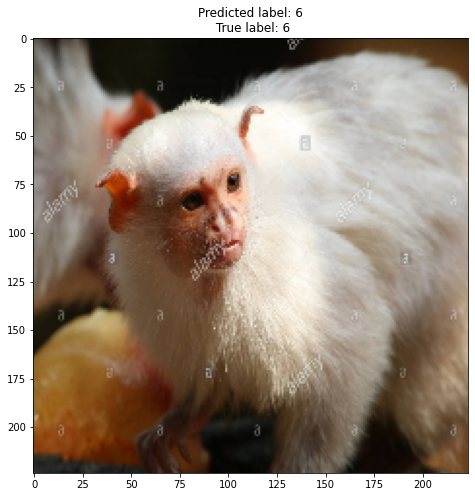

In [ ]:
plt.subplot(1,2,1)
plt.title("Predicted label: "+str(np.argmax(model1.predict(sample_image_processed), axis=-1)[0])+"\n True label: "+str(true_label))
plt.imshow(sample_image)# <- Image is ready to plot

fmaps = []
for x in range(2,22,1):
  vis_model=get_n_layers(x,model1)
  fet_maps_stacked=vis_model.predict(sample_image_processed)[0,:,:,:]
  dim0,dim1,dim2,dim3  = vis_model.output_shape
  feature_maps=np.zeros((dim1*8,dim2*8))
  k=0
  for i in range(8):
    for j in range(8):
        feature_map = fet_maps_stacked[:,:,k]
        feature_map -= feature_map.mean()
        feature_map /= feature_map.std()
        feature_map *=255
        feature_map = np.clip(feature_map, 0, 255).astype(np.uint8)
        feature_maps[dim1*i:dim1*(i+1),dim1*j:dim1*(j+1)]=feature_map
        k+=1
  fmaps.append(feature_maps)
plt.show()

20


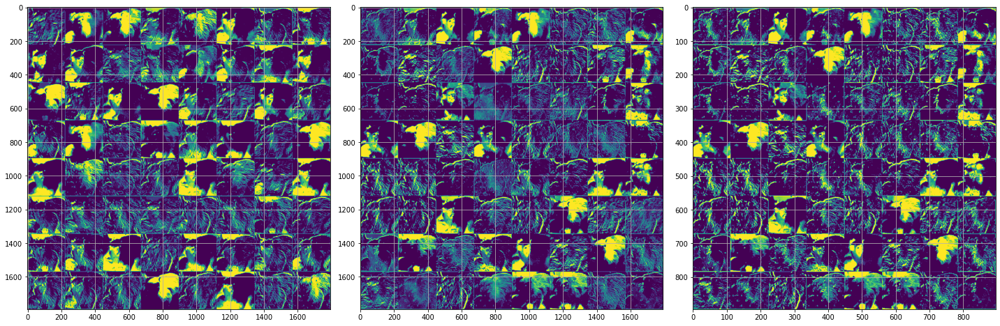

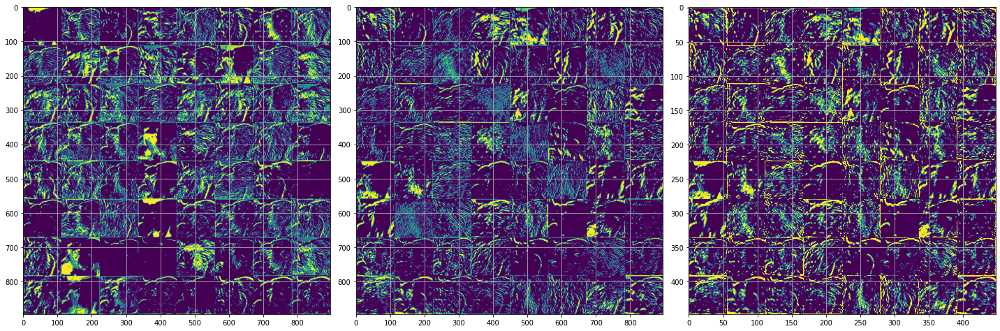

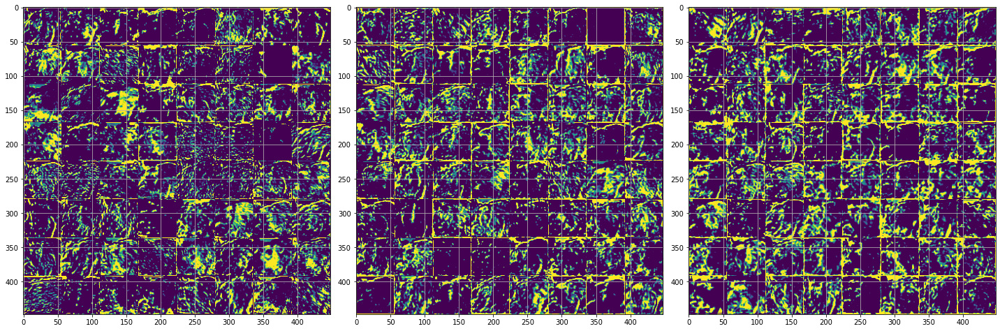

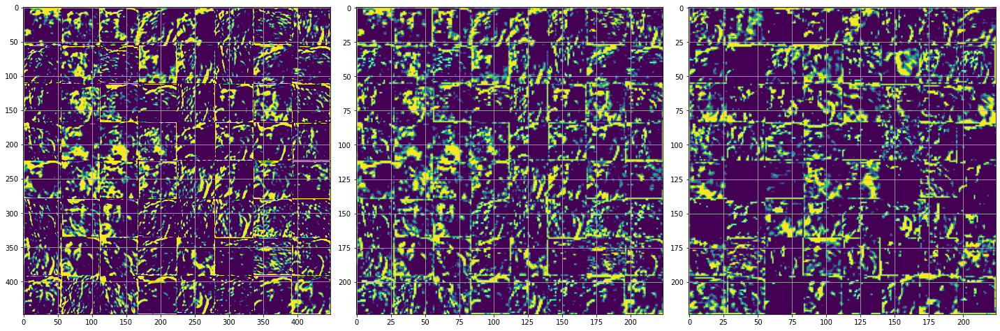

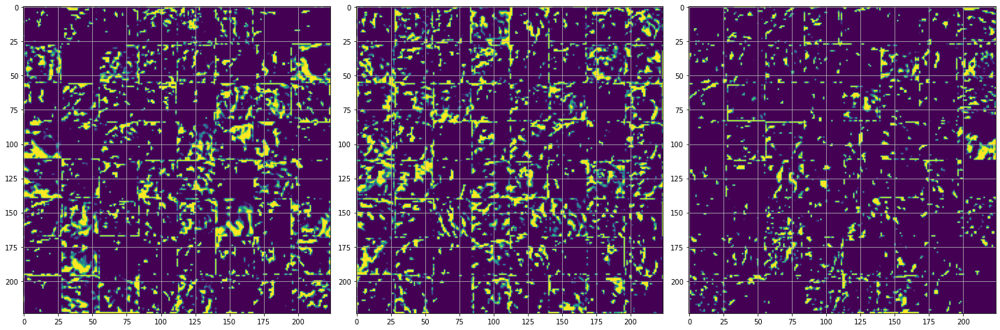

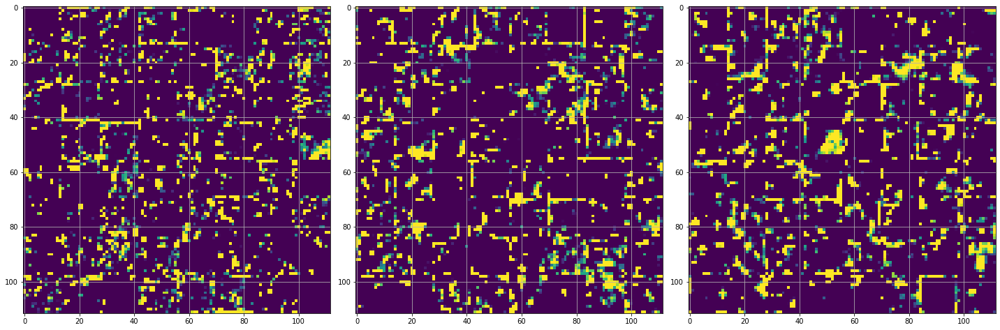

In [ ]:
fs = len(fmaps)
print(fs)
plt.rcParams['figure.figsize'] = [20,20]
for x in range(6):
  for y in range(3): 
    if (3*x)+y == fs:
      break
    plt.subplot(1,3,y+1)
    #print(3*x+y)
    plt.imshow(fmaps[3*x+y])
    plt.tight_layout()
    plt.grid()
  plt.show()
  if (3*x)+y == fs:
      break

## 3.d CNN con skip connections

Otra manera de mejorar los resultados de las redes, sobretodo de las redes profundas donde se observa el problema de _vanishing gradient_ son las relativamente nuevas _skip connections_ o redes residuales. En vez de preocuparse de cómo manejar los pesos de la red para permitir que el gradiente no explote o no desaparezca, se permite al gradiente "pasar" sin ser modificado, agregando conecciones con pesos fijos entre capas de distintas profundidades, en la práctica permitiendo a la señar "saltarse" las capas intermedias. Esta idea ha permitido desarrollos como los de ResNet, llegando a profundidades de cientos de capas y aún logrando aprendizaje. 

Basandose en el código mostrado abajo, implemente una ResNet de su gusto. _Tip: Utilice BatchNormalization después de cada capa convolucional._

**Obtenga un error de validación superior al 50%**. _No tenga miedo de subir la profundidad, pero sí de la cantidad de hiperparámetros a entrenar, checkear model.summary()_

**Repita los pasos II) a IV) de las secciones anteriores. Comente**

In [ ]:
from keras.models import Sequential
from keras.layers import Dense, Flatten, Add,Activation
from keras.layers import Conv2D, MaxPooling2D, AveragePooling2D, ZeroPadding2D, Input, concatenate
from keras.optimizers import RMSprop
from keras.callbacks import History, EarlyStopping
from keras.layers.normalization import BatchNormalization
from keras.initializers import glorot_uniform
import tensorflow as tf
tf.keras.backend.clear_session()
tf.compat.v1.disable_eager_execution()

x = Input(shape=(img_rows, img_cols, img_channels))
print(img_rows, img_cols, img_channels)
X_shortcut = x #guardar el valor de la red

conv_name_base = 'conv11'
bn_name_base = 'batch11'
# Zero-Padding
X = ZeroPadding2D((3, 3))(x)

# Stage 1
X = Conv2D(64, (7, 7), strides=(2, 2), name='conv1', kernel_initializer=glorot_uniform(seed=0))(X)
X = BatchNormalization(axis=3, name='bn_conv1')(X)
X = Activation('relu')(X)
X = MaxPooling2D((3, 3), strides=(2, 2))(X)

X_shortcut = X

##### MAIN PATH #####
# First component of main path 
X = Conv2D(64, (1, 1), strides = (2,2), name = conv_name_base + '2a', kernel_initializer = glorot_uniform(seed=0))(X)
X = BatchNormalization(axis = 3, name = bn_name_base + '2a')(X)
X = Activation('relu')(X)
print(X.shape)
# Second component of main path (≈3 lines)
X = Conv2D(filters = 64, kernel_size = (3, 3), strides = (1,1), padding = 'same', name = conv_name_base + '2b', kernel_initializer = glorot_uniform(seed=0))(X)
X = BatchNormalization(axis = 3, name = bn_name_base + '2b')(X)
X = Activation('relu')(X)
print(X.shape)

# Third component of main path (≈2 lines)
X = Conv2D(filters = 256, kernel_size = (1, 1), strides = (1,1), padding = 'valid', name = conv_name_base + '2c', kernel_initializer = glorot_uniform(seed=0))(X)
X = BatchNormalization(axis = 3, name = bn_name_base + '2c')(X)
print(X.shape)

##### SHORTCUT PATH #### (≈2 lines)
X_shortcut = Conv2D(filters = 256, kernel_size = (1, 1), strides = (2,2), padding = 'valid', name = conv_name_base + '1',
                    kernel_initializer = glorot_uniform(seed=0))(X_shortcut)
X_shortcut = BatchNormalization(axis = 3, name = bn_name_base + '1')(X_shortcut)
print(X_shortcut)
# Final step: Add shortcut value to main path, and pass it through a RELU activation (≈2 lines)
X = Add()([X, X_shortcut])
X = Activation('relu')(X)
print(X.shape)

X_shortcut = X
##### MAIN PATH #####
# First component of main path 
X = Conv2D(64, (1, 1), strides = (2,2), name = conv_name_base + '21a', kernel_initializer = glorot_uniform(seed=0))(X)
X = BatchNormalization(axis = 3, name = bn_name_base + '21a')(X)
X = Activation('relu')(X)
print(X.shape)

# Second component of main path (≈3 lines)
X = Conv2D(filters = 64, kernel_size = (3, 3), strides = (1,1), padding = 'same', name = conv_name_base + '21b', kernel_initializer = glorot_uniform(seed=0))(X)
X = BatchNormalization(axis = 3, name = bn_name_base + '21b')(X)
X = Activation('relu')(X)
print(X.shape)

# Third component of main path (≈2 lines)
X = Conv2D(filters = 256, kernel_size = (1, 1), strides = (1,1), padding = 'valid', name = conv_name_base + '21c', kernel_initializer = glorot_uniform(seed=0))(X)
X = BatchNormalization(axis = 3, name = bn_name_base + '21c')(X)
print(X.shape)

##### SHORTCUT PATH #### (≈2 lines)
X_shortcut = Conv2D(filters = 256, kernel_size = (1, 1), strides = (2,2), padding = 'valid', name = conv_name_base + '11',
                    kernel_initializer = glorot_uniform(seed=0))(X_shortcut)
X_shortcut = BatchNormalization(axis = 3, name = bn_name_base + '11')(X_shortcut)
print(X_shortcut)

# Final step: Add shortcut value to main path, and pass it through a RELU activation (≈2 lines)
X = Add()([X, X_shortcut])
X = Activation('relu')(X)

X_shortcut = X
##### MAIN PATH #####
# First component of main path 
X = Conv2D(64, (1, 1), strides = (2,2), name = conv_name_base + '211a', kernel_initializer = glorot_uniform(seed=0))(X)
X = BatchNormalization(axis = 3, name = bn_name_base + '211a')(X)
X = Activation('relu')(X)
print(X.shape)

# Second component of main path (≈3 lines)
X = Conv2D(filters = 64, kernel_size = (3, 3), strides = (1,1), padding = 'same', name = conv_name_base + '211b', kernel_initializer = glorot_uniform(seed=0))(X)
X = BatchNormalization(axis = 3, name = bn_name_base + '211b')(X)
X = Activation('relu')(X)
print(X.shape)

# Third component of main path (≈2 lines)
X = Conv2D(filters = 256, kernel_size = (1, 1), strides = (1,1), padding = 'valid', name = conv_name_base + '211c', kernel_initializer = glorot_uniform(seed=0))(X)
X = BatchNormalization(axis = 3, name = bn_name_base + '211c')(X)
print(X.shape)

##### SHORTCUT PATH #### (≈2 lines)
X_shortcut = Conv2D(filters = 256, kernel_size = (1, 1), strides = (2,2), padding = 'valid', name = conv_name_base + '111',
                    kernel_initializer = glorot_uniform(seed=0))(X_shortcut)
X_shortcut = BatchNormalization(axis = 3, name = bn_name_base + '111')(X_shortcut)
print(X_shortcut)

# Final step: Add shortcut value to main path, and pass it through a RELU activation (≈2 lines)
X = Add()([X, X_shortcut])
X = Activation('relu')(X)

# . . . 
z = AveragePooling2D((2,2), name="avg_pool")(X)
z = Flatten()(z)
z = Dense(256 + 64, activation='relu')(z)
z = BatchNormalization()(z)
out = Dense(10, activation='softmax')(z)

res_mod1 = tf.keras.models.Model(x,out)

my_callbacks = [History(), # Returns validation and training loss
    EarlyStopping(patience=2,monitor="val_accuracy", #Stops training when the validation loss doesnt get better in n°patience consecutive epochs,keep it at 100 it's only to show u
                                     restore_best_weights=True)]


optimizer = RMSprop(0.001)
res_mod1.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
# summary
res_mod1.summary()

224 224 3
(None, 28, 28, 64)
(None, 28, 28, 64)
(None, 28, 28, 256)
Tensor("batch111/cond/Identity:0", shape=(None, 28, 28, 256), dtype=float32)
(None, 28, 28, 256)
(None, 14, 14, 64)
(None, 14, 14, 64)
(None, 14, 14, 256)
Tensor("batch1111/cond/Identity:0", shape=(None, 14, 14, 256), dtype=float32)
(None, 7, 7, 64)
(None, 7, 7, 64)
(None, 7, 7, 256)
Tensor("batch11111/cond/Identity:0", shape=(None, 7, 7, 256), dtype=float32)
Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
zero_padding2d (ZeroPadding2D)  (None, 230, 230, 3)  0           input_1[0][0]                    
_____________________________________________________

In [ ]:
# number of training and validation steps for training and validation
nb_train_steps = int(np.ceil(len(train_df)/batch_size))
nb_valid_steps = int(np.ceil(len(valid_df)/batch_size))
# number of epochs 
nb_epochs=10 # si no obtuvo el resultado deseado en 10 epochs 

hist = res_mod1.fit(train_data_gen,      # ¿Demasiado lento?, revisar estar usando entorno de ejecución en modo GPU. Debiese demorarse aprox. 40 secs por epoch. Dejar verbose
                                          # para seguir el entrenamiento, esto tomará su tiempo en comparación con las demás secciones.
                              epochs=nb_epochs, 
                              steps_per_epoch=nb_train_steps, 
                              validation_data=valid_data_gen, 
                              validation_steps=nb_valid_steps,
                              callbacks=my_callbacks)

Epoch 1/10
137/137 [==============================] - 38s 277ms/step - batch: 68.0000 - size: 8.0000 - loss: 2.0597 - accuracy: 0.3312 - val_loss: 3.1952 - val_accuracy: 0.0956
Epoch 2/10
137/137 [==============================] - 38s 275ms/step - batch: 68.0000 - size: 8.0000 - loss: 1.6622 - accuracy: 0.4261 - val_loss: 3.5142 - val_accuracy: 0.0956
Epoch 3/10
137/137 [==============================] - 38s 274ms/step - batch: 68.0000 - size: 8.0000 - loss: 1.3824 - accuracy: 0.5374 - val_loss: 3.7261 - val_accuracy: 0.1103
Epoch 4/10
137/137 [==============================] - 39s 284ms/step - batch: 68.0000 - size: 8.0000 - loss: 1.2751 - accuracy: 0.5493 - val_loss: 4.0748 - val_accuracy: 0.0956
Epoch 5/10
137/137 [==============================] - 38s 274ms/step - batch: 68.0000 - size: 8.0000 - loss: 1.1413 - accuracy: 0.6049 - val_loss: 3.8658 - val_accuracy: 0.0956


II)

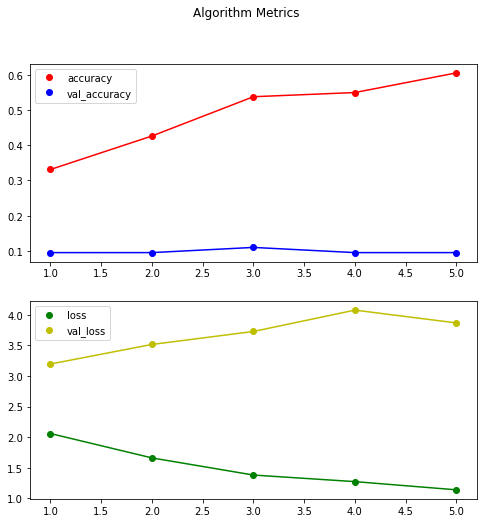

In [ ]:
import matplotlib.pyplot as plt
hist.history
hist.history['accuracy']
hist.history['val_accuracy']
hist.history['loss']
hist.history['val_loss']

r = range(1,6,1)
plt.rcParams['figure.figsize'] = [8,8]
fig, ax = plt.subplots(2)
#fig.set_size_inches(18.5, 10.5)
fig.suptitle('Algorithm Metrics')
ax[0].plot(r, hist.history['accuracy'], 'ro', label='accuracy')
ax[0].plot(r, hist.history['val_accuracy'], 'bo', label='val_accuracy')
ax[0].plot(r, hist.history['accuracy'], 'r')
ax[0].plot(r, hist.history['val_accuracy'], 'b')
ax[0].legend()
#axs[0].show()
ax[1].plot(r, hist.history['loss'], 'go', label='loss')
ax[1].plot(r, hist.history['val_loss'], 'yo', label='val_loss')
ax[1].plot(r, hist.history['loss'], 'g')
ax[1].plot(r, hist.history['val_loss'], 'y')
ax[1].legend()
fig.show()


Comentario: Los resultados dan valores de accuracy muy bajo en el conjunto de validacion, en el conjunto de entrenamiento los valores tambien no salen tan bajo como en el conjunto de validacion. El error tambien es bastante alto. El error es superior a 1 en el conjunto de validacion y se encuentra entre 3 y 4 en el conjunto de entrenamiento.

III) 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:53: RuntimeWarning: invalid value encountered in true_divide


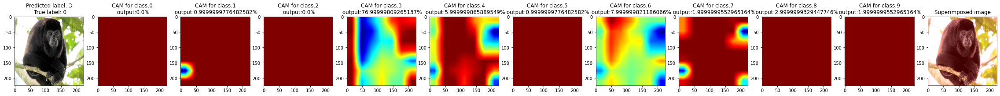

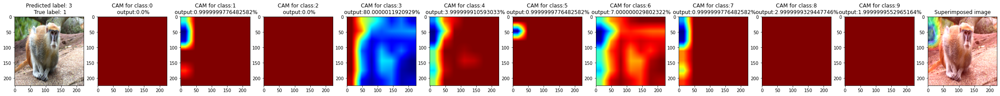

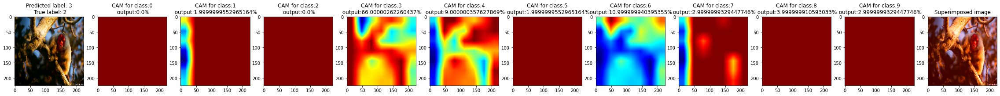

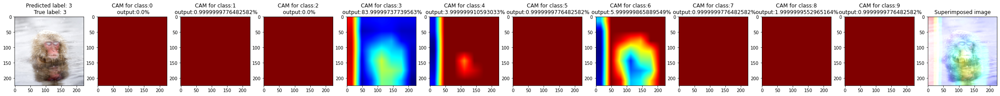

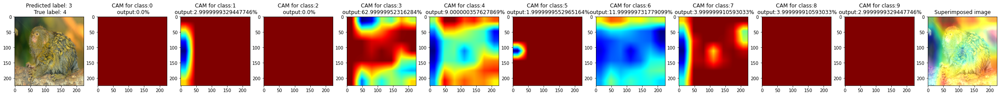

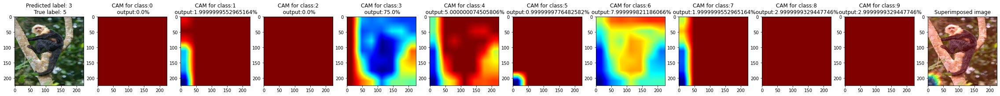

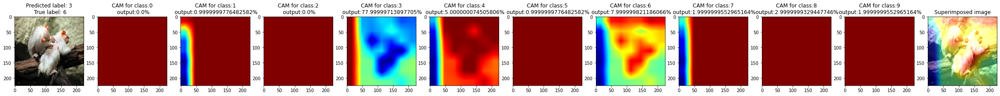

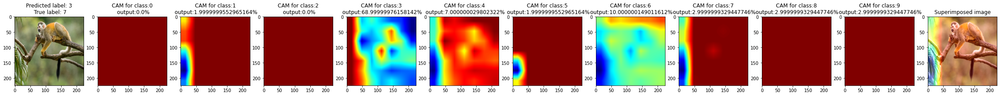

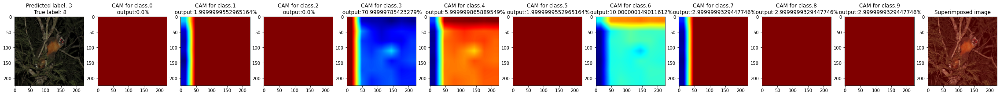

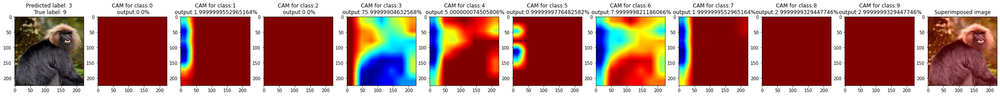

In [ ]:
plt.rcParams["figure.figsize"]=[40,8]
from keras import backend as K

for j in range(0,10,1):
  
  while True:
    # get random image, true label, and predicted label
    idx= np.random.randint(100) # <- random number
    true_label=valid_df.iloc[idx]['label']
    if(j == true_label):
        break
  

  ####### VISUALIZACIÓN INPUT
  sample_image = cv2.imread(valid_df.iloc[idx]['image'])
  sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)
  sample_image = cv2.resize(sample_image, (img_rows, img_cols))
  sample_label = valid_df.iloc[idx]["label"]
  sample_image_processed = np.expand_dims(sample_image, axis=0)
  sample_image_processed = preprocess_input(sample_image_processed)
  predicted_label=np.argmax(res_mod1.predict(sample_image_processed), axis=-1)[0]
  plt.subplot(1,12,1)
  plt.title("Predicted label: "+str(predicted_label)+"\n True label: "+str(true_label))
  plt.imshow(sample_image)# <- Image is ready to plot

  ##### Visualización CAM
  heatmaps=[]
  kk=0
  predicted_label=np.argmax(res_mod1.predict(sample_image_processed), axis=-1)[0] #repeated for clearness
  for k in range(0,10,1):#[0,predicted_label]:
    predicted_output = res_mod1.output[:, k]
    # choose the last conv layer in your model
    last_conv_layer = res_mod1.get_layer('conv11111') #<....... you'll need to look what's the name of the last conv model.summary())
    grads = K.gradients(predicted_output, last_conv_layer.output)[0] #predicted output=loss, last_conv_layer=input al gradiente, ¿qué calculará el gradiente entonces?
    # take mean gradient per feature map
    grads = K.mean(grads, axis=(0,1,2))
    # Define a function that generates the values for the output and gradients
    evaluation_function = K.function([res_mod1.input], [grads, last_conv_layer.output[0]]) #en eager executions disabled estamos trabajando con tensores continuamente, 
                                                                                        # si siguen el código se darán cuenta que evaluation function mantiene 
                                                                                        # las definiciones de variables
    # get the values
    grads_values, conv_ouput_values = evaluation_function([sample_image_processed]) #run evaluation function
    # iterate over each feature map in yout conv output and multiply
    # the gradient values with the conv output values. This gives an 
    # indication of "how important a feature is"
    for i in range(conv_ouput_values.shape[-1]): # we have 512 features in our last conv layer
        conv_ouput_values[:,:,i] *= grads_values[i]
    # create a heatmap
    heatmap = np.mean(conv_ouput_values, axis=-1)
    # remove negative values
    heatmap = np.maximum(heatmap, 0)
    # re-scale
    heatmap /= heatmap.max()
    # get the heatmap for class activation map(CAM)
    heatmap = cv2.resize(heatmap, (sample_image.shape[0], sample_image.shape[1]))
    heatmap = heatmap *255
    heatmap = np.clip(heatmap, 0, 255).astype(np.uint8)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    plt.subplot(1,12,2+kk)
    plt.title("CAM for class:"+ str(k)+"\n output:"+str(np.round(res_mod1.predict(sample_image_processed)[0,k],2)*100)+"%")
    plt.imshow(heatmap)# <- Image is ready to plot
    kk+=1
    heatmaps.append(heatmap) # <- correct it
  # get the superimposed image
  super_imposed_image = heatmaps[j] * 0.5 + sample_image #<- correct it  
  super_imposed_image = np.clip(super_imposed_image, 0,255).astype(np.uint8)
  plt.subplot(1,12,12)
  plt.title("Superimposed image")
  plt.imshow(super_imposed_image)# <- Image is ready to plot
  plt.show()

IV)

In [ ]:
# get random image, SELECCIONE UNA A GUSTO
idx= 73 #np.random.randint(100) # <- random number
true_label=valid_df.iloc[73]['label']
####### VISUALIZACIÓN INPUT
sample_image = cv2.imread(valid_df.iloc[idx]['image'])
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)
sample_image = cv2.resize(sample_image, (img_rows, img_cols))
sample_label = valid_df.iloc[idx]["label"]
sample_image_processed = np.expand_dims(sample_image, axis=0)
sample_image_processed = preprocess_input(sample_image_processed)
print(idx)

73


In [ ]:
from keras.models import Sequential
from keras.models import Model
def get_n_layers(max_layer, original_model):
  print(len(original_model.layers))
  m_size = len(original_model.layers)
  nm_size = m_size - max_layer
  print("nm:D ", nm_size)
  before_gap_layer = original_model.layers[-nm_size]
  class_pred_layer = original_model.layers[-1]
  outputs = before_gap_layer.output #, class_pred_layer.output
  #layer_outputs = [layer.output for layer in original_model.layers[:max_layer]]
  resnet50_cam_layers = Model(inputs=original_model.input, outputs=outputs)

  # only access the first element of weights, we won't be needing the bias term here
  class_weights = class_pred_layer.get_weights()[0]
  resnet50_cam_layers.summary()
  return resnet50_cam_layers
def get_n_layerss(max_layer, original_model):
  truncated_model = Sequential()
  for layer in range(max_layer): #first is the input
    X = original_model.get_layer(index=layer)
    print(layer)
    print(X)
    #print(layer.__class__.__name__,'output shape:\t', X)
    truncated_model.add(original_model.get_layer(index=layer))
  truncated_model.summary()
  return truncated_model

47
nm:D  44
Model: "functional_83"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
zero_padding2d (ZeroPadding2 (None, 230, 230, 3)       0         
_________________________________________________________________
conv1 (Conv2D)               (None, 112, 112, 64)      9472      
_________________________________________________________________
bn_conv1 (BatchNormalization (None, 112, 112, 64)      256       
Total params: 9,728
Trainable params: 9,600
Non-trainable params: 128
_________________________________________________________________
47
nm:D  43
Model: "functional_85"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
__

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in true_divide
  app.launch_new_instance()


47
nm:D  42
Model: "functional_87"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
zero_padding2d (ZeroPadding2 (None, 230, 230, 3)       0         
_________________________________________________________________
conv1 (Conv2D)               (None, 112, 112, 64)      9472      
_________________________________________________________________
bn_conv1 (BatchNormalization (None, 112, 112, 64)      256       
_________________________________________________________________
activation (Activation)      (None, 112, 112, 64)      0         
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 55, 55, 64)        0         
Total params: 9,728
Trainable params: 9,600
Non-trainable params: 128
_____________________________________

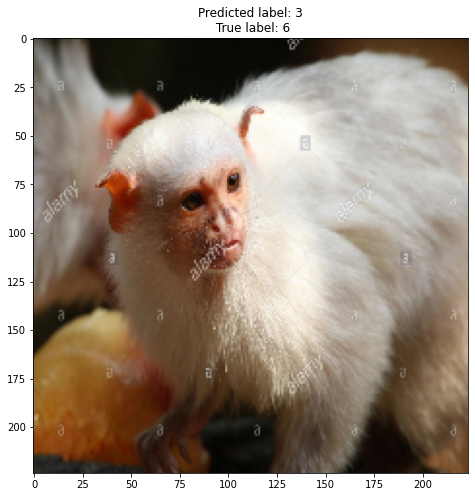

In [ ]:
plt.subplot(1,2,1)
plt.title("Predicted label: "+str(np.argmax(res_mod1.predict(sample_image_processed), axis=-1)[0])+"\n True label: "+str(true_label))
plt.imshow(sample_image)# <- Image is ready to plot

fmaps = []
for x in range(3,43,1):
  vis_model=get_n_layers(x,res_mod1)
  fet_maps_stacked=vis_model.predict(sample_image_processed)[0,:,:,:]
  dim0,dim1,dim2,dim3  = vis_model.output_shape
  feature_maps=np.zeros((dim1*8,dim2*8))
  k=0
  for i in range(8):
    for j in range(8):
        feature_map = fet_maps_stacked[:,:,k]
        feature_map -= feature_map.mean()
        feature_map /= feature_map.std()
        feature_map *=255
        feature_map = np.clip(feature_map, 0, 255).astype(np.uint8)
        feature_maps[dim1*i:dim1*(i+1),dim1*j:dim1*(j+1)]=feature_map
        k+=1
  fmaps.append(feature_maps)
plt.show()

40


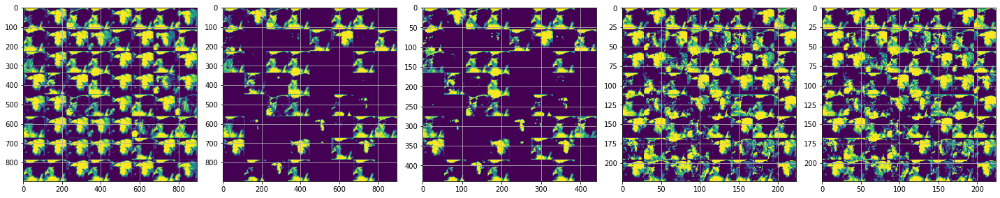

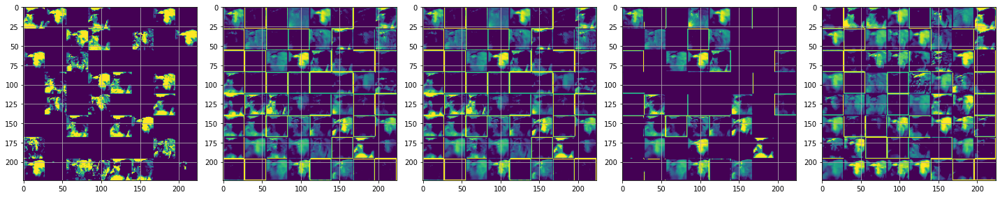

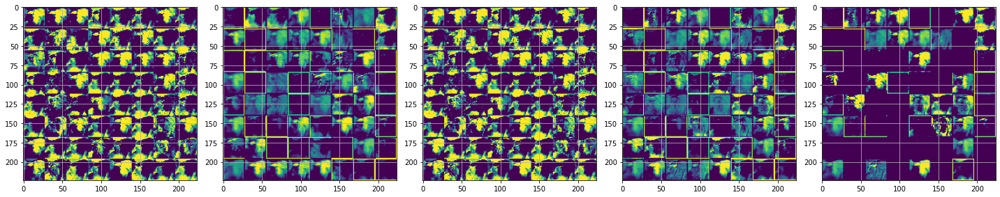

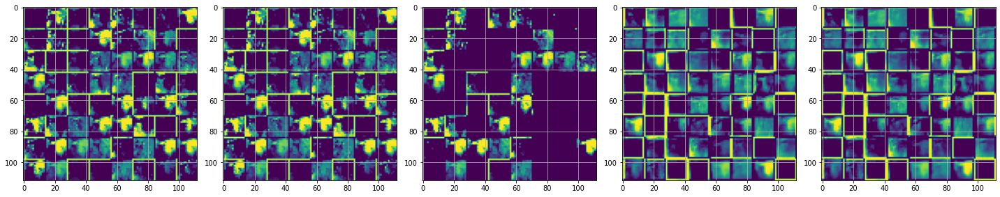

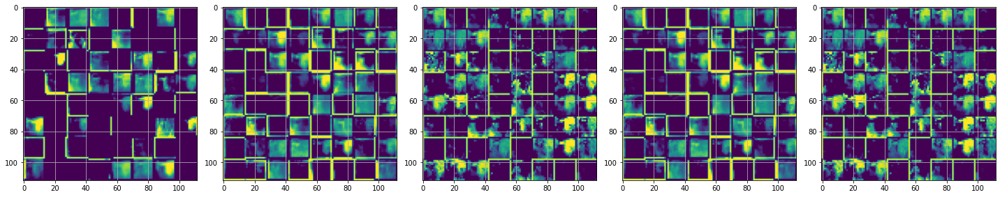

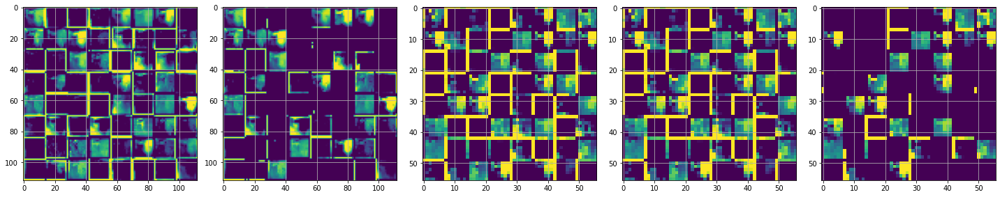

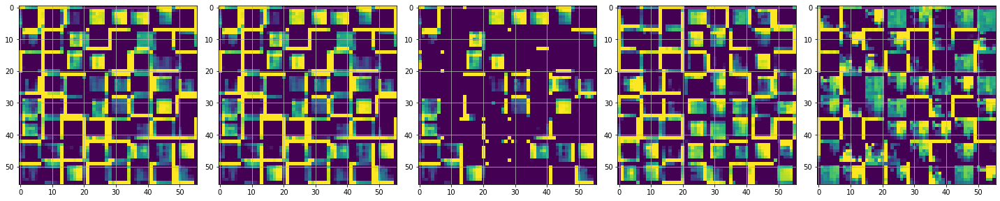

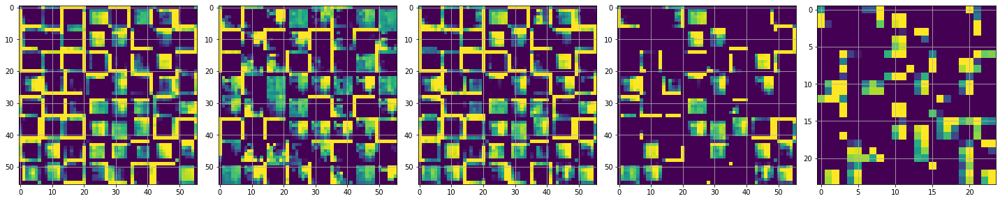

In [ ]:
fs = len(fmaps)
print(fs)
plt.rcParams['figure.figsize'] = [20,20]
for x in range(8):
  for y in range(5): 
    if (5*x)+y == fs:
      break
    plt.subplot(1,5,y+1)
    #print(5*x+y)
    plt.imshow(fmaps[5*x+y])
    plt.tight_layout()
    plt.grid()
  plt.show()
  if (5*x)+y == fs:
      break

Comentarios: Se puede ver en los features que no detecta cosas muy bien, aunque son muchas capas y feature por capa igual no detecta en ciertas zonas.
Conclusion: La mejor red de las 3 realizadas en la seccion de transfer learning es la arquitectura VGG16 como base. La que tiene el rendimiento mas bajo es la tercera red que se implemento con skip connections en arquitectura de red residual.
1. VGG16
2. VGG19
3. skip connection - res-net
